# Bab 1 - Import Libraries

> Pertama saya akan import library yang diperlukan dalam proses pembuatan model

In [112]:
# Import libraries

import os
import glob
import random
import json
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import seaborn as sns
import tensorflow as tf
from tensorflow.keras.utils import plot_model
from jmd_imagescraper.core import *
from sklearn.metrics import classification_report, confusion_matrix

# Untuk menghilangkan warning pada notebook
import warnings
warnings.filterwarnings("ignore")

In [2]:
tf.__version__

'2.15.1'

# Bab 2 - Data Loading

> Saya akan load dataset yang telah saya download dari [Kaggle Dataset](https://www.kaggle.com/datasets/raunakgola/paws-people-and-pals-a-visual-trio). Dataset ini telah saya masukkan ke dalam lokal.

## Data Train

Pertama saya akan tuliskan path dataset saya lalu rename file sesuai classnya dengan dimulai dari angka 1.

In [3]:
# Renaming filenames of each category

cat_files = glob.glob('data/train_data/cat/*')
# num = 1
# for cf in cat_files:
#   os.rename(cf, 'data/train_data/cat/cat_' + "{:03d}".format(num) + '.jpg')
#   num += 1

dog_files = glob.glob('data/train_data/dog/*')
# num = 1
# for df in dog_files:
#   os.rename(df, 'data/train_data/dog/dog_' + "{:03d}".format(num) + '.jpg')
#   num += 1

human_files = glob.glob('data/train_data/human/*')
# num = 1
# for hf in human_files:
#   os.rename(hf, 'data/train_data/human/human_' + "{:03d}".format(num) + '.jpg')
#   num += 1

Karena saya akan menggunakan dataframe dalam mengolah data train dan val. Saya akan listing terlebih dahulu datasetnya agar memudahkan dalam proses penggabungan kedalam dataframenya.

In [4]:
# Listing images of each category

cat_files.sort()
dog_files.sort()
human_files.sort()

print('cat_files : ', cat_files[:5])
print(f'total cat_files : {len(cat_files)}')
print('')
print('dog_files : ', dog_files[:5])
print(f'total dog_files : {len(dog_files)}')
print('')
print('human_files :', human_files[:5])
print(f'total human_files : {len(human_files)}')

cat_files :  ['data/train_data/cat\\cat_001.jpg', 'data/train_data/cat\\cat_002.jpg', 'data/train_data/cat\\cat_003.jpg', 'data/train_data/cat\\cat_004.jpg', 'data/train_data/cat\\cat_005.jpg']
total cat_files : 1536

dog_files :  ['data/train_data/dog\\dog_001.jpg', 'data/train_data/dog\\dog_002.jpg', 'data/train_data/dog\\dog_003.jpg', 'data/train_data/dog\\dog_004.jpg', 'data/train_data/dog\\dog_005.jpg']
total dog_files : 1536

human_files : ['data/train_data/human\\human_001.jpg', 'data/train_data/human\\human_002.jpg', 'data/train_data/human\\human_003.jpg', 'data/train_data/human\\human_004.jpg', 'data/train_data/human\\human_005.jpg']
total human_files : 1536


Selanjutnya akan saya gabungkan semua classnya menjadi satu dataframe yang nanti akan di split menjadi data train dan validation.

In [5]:
# Create a Pandas DataFrame that contains the path of all images

all_files = cat_files + dog_files + human_files
labels = ['cat' for i in range(len(cat_files))] + ['dog' for i in range(len(dog_files))] + ['human' for i in range(len(human_files))]
img_df = pd.DataFrame({'images':all_files, 'label':labels})
img_df = img_df.sample(len(img_df),random_state=27).reset_index(drop=True)
img_df

,images,label
0,data/train_data/human\human_627.jpg,human
1,data/train_data/cat\cat_543.jpg,cat
2,data/train_data/dog\dog_558.jpg,dog
3,data/train_data/cat\cat_1223.jpg,cat
4,data/train_data/cat\cat_1256.jpg,cat
...,...,...
4603,data/train_data/cat\cat_490.jpg,cat
4604,data/train_data/dog\dog_857.jpg,dog
4605,data/train_data/human\human_629.jpg,human
4606,data/train_data/human\human_304.jpg,human


Berikut merupakan contoh gambaran dataset yang saya miliki. Saya akan menampilkan 10 gambar random dari dataset untuk setiap classnya.

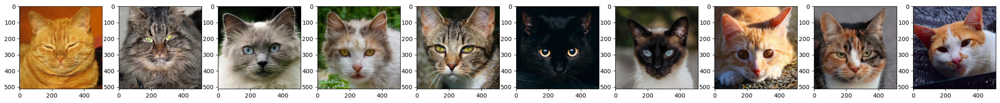

In [6]:
# Show Cat images

random.seed(27)
sampled_cats = random.sample(cat_files, 10)

fig, ax = plt.subplots(ncols=10, figsize=(30,3))
for i in range(10):
  cat = plt.imread(sampled_cats[i])
  ax[i].imshow(cat)

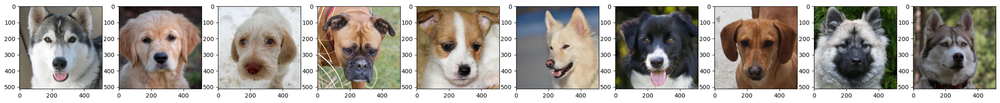

In [7]:
# Show dog images

random.seed(27)
sampled_dogs = random.sample(dog_files, 10)

fig, ax = plt.subplots(ncols=10, figsize=(30,3))
for i in range(10):
  dog = plt.imread(sampled_dogs[i])
  ax[i].imshow(dog)

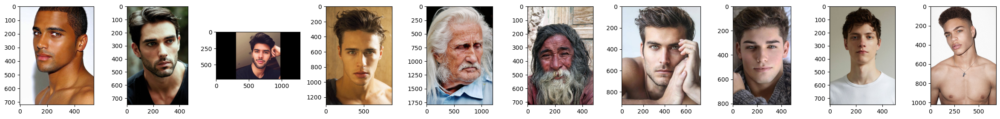

In [8]:
# Show human images

random.seed(27)
sampled_human = random.sample(human_files, 10)

fig, ax = plt.subplots(ncols=10, figsize=(30,3))
for i in range(10):
  human = plt.imread(sampled_human[i])
  ax[i].imshow(human)

Selanjutnya saya akan rename file data test dan juga mengubah informasi data test menjadi dataframe.

## Data Test

In [9]:
# Renaming filenames of each category

test_cat_files = glob.glob('data/test_data/cat/*')
# num = 1
# for cf in cat_files:
#   os.rename(cf, 'data/test_data/cat/cat_' + "{:03d}".format(num) + '.jpg')
#   num += 1

test_dog_files = glob.glob('data/test_data/dog/*')
# num = 1
# for df in dog_files:
#   os.rename(df, 'data/test_data/dog/dog_' + "{:03d}".format(num) + '.jpg')
#   num += 1

test_human_files = glob.glob('data/test_data/human/*')
# num = 1
# for hf in human_files:
#   os.rename(hf, 'data/test_data/human/human_' + "{:03d}".format(num) + '.jpg')
#   num += 1

In [10]:
# Listing images of each category

test_cat_files.sort()
test_dog_files.sort()
test_human_files.sort()

print('cat_files : ', test_cat_files[:5])
print(f'total cat_files : {len(test_cat_files)}')
print('')
print('dog_files : ', test_dog_files[:5])
print(f'total dog_files : {len(test_dog_files)}')
print('')
print('human_files :', test_human_files[:5])
print(f'total human_files : {len(test_human_files)}')

cat_files :  ['data/test_data/cat\\cat_001.jpg', 'data/test_data/cat\\cat_002.jpg', 'data/test_data/cat\\cat_003.jpg', 'data/test_data/cat\\cat_004.jpg', 'data/test_data/cat\\cat_005.jpg']
total cat_files : 384

dog_files :  ['data/test_data/dog\\dog_001.jpg', 'data/test_data/dog\\dog_002.jpg', 'data/test_data/dog\\dog_003.jpg', 'data/test_data/dog\\dog_004.jpg', 'data/test_data/dog\\dog_005.jpg']
total dog_files : 384

human_files : ['data/test_data/human\\human_001.jpg', 'data/test_data/human\\human_002.jpg', 'data/test_data/human\\human_003.jpg', 'data/test_data/human\\human_004.jpg', 'data/test_data/human\\human_005.jpg']
total human_files : 384


In [11]:
# Create a Pandas DataFrame that contains the path of all images

all_files = test_cat_files + test_dog_files + test_human_files
labels = ['cat' for i in range(len(test_cat_files))] + ['dog' for i in range(len(test_dog_files))] + ['human' for i in range(len(test_human_files))]
test_img_df = pd.DataFrame({'images':all_files, 'label':labels})
test_img_df = test_img_df.sample(len(test_img_df),random_state=27).reset_index(drop=True)
test_img_df

,images,label
0,data/test_data/dog\dog_022.jpg,dog
1,data/test_data/cat\cat_185.jpg,cat
2,data/test_data/cat\cat_266.jpg,cat
3,data/test_data/dog\dog_103.jpg,dog
4,data/test_data/dog\dog_156.jpg,dog
...,...,...
1147,data/test_data/cat\cat_142.jpg,cat
1148,data/test_data/human\human_281.jpg,human
1149,data/test_data/dog\dog_369.jpg,dog
1150,data/test_data/dog\dog_160.jpg,dog


## Loading Image Data in Tensorflow

Dataset sudah berhasil dirubah semuanya kedalam dataframe, sehingga mampu dimasukan kedalam imagegenerator untuk dilakukan modeling nanti.

In [12]:
img_df

,images,label
0,data/train_data/human\human_627.jpg,human
1,data/train_data/cat\cat_543.jpg,cat
2,data/train_data/dog\dog_558.jpg,dog
3,data/train_data/cat\cat_1223.jpg,cat
4,data/train_data/cat\cat_1256.jpg,cat
...,...,...
4603,data/train_data/cat\cat_490.jpg,cat
4604,data/train_data/dog\dog_857.jpg,dog
4605,data/train_data/human\human_629.jpg,human
4606,data/train_data/human\human_304.jpg,human


In [13]:
test_img_df

,images,label
0,data/test_data/dog\dog_022.jpg,dog
1,data/test_data/cat\cat_185.jpg,cat
2,data/test_data/cat\cat_266.jpg,cat
3,data/test_data/dog\dog_103.jpg,dog
4,data/test_data/dog\dog_156.jpg,dog
...,...,...
1147,data/test_data/cat\cat_142.jpg,cat
1148,data/test_data/human\human_281.jpg,human
1149,data/test_data/dog\dog_369.jpg,dog
1150,data/test_data/dog\dog_160.jpg,dog


# Bab 3 - Exploratory Data Analysis (EDA)

Selanjutnya saya akan melakukan proses EDA pada dataset

## Sampling Image for EDA

Pertama saya akan menampilkan 50 gambar pada masing-masing class untuk dilakukan analisis.

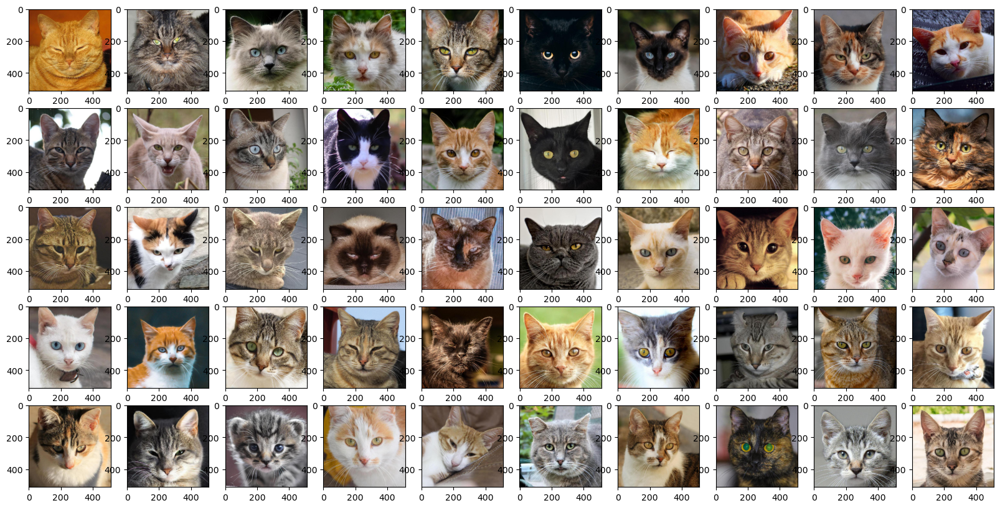

In [14]:
# Show Cat images

random.seed(27)
sampled_cats = random.sample(cat_files, 50)

fig, ax = plt.subplots(nrows=5, ncols=10, figsize=(20,10))
for idx in range(50):
  row = idx // 10
  col = idx % 10
  cat = plt.imread(sampled_cats[idx])
  ax[row][col].imshow(cat)

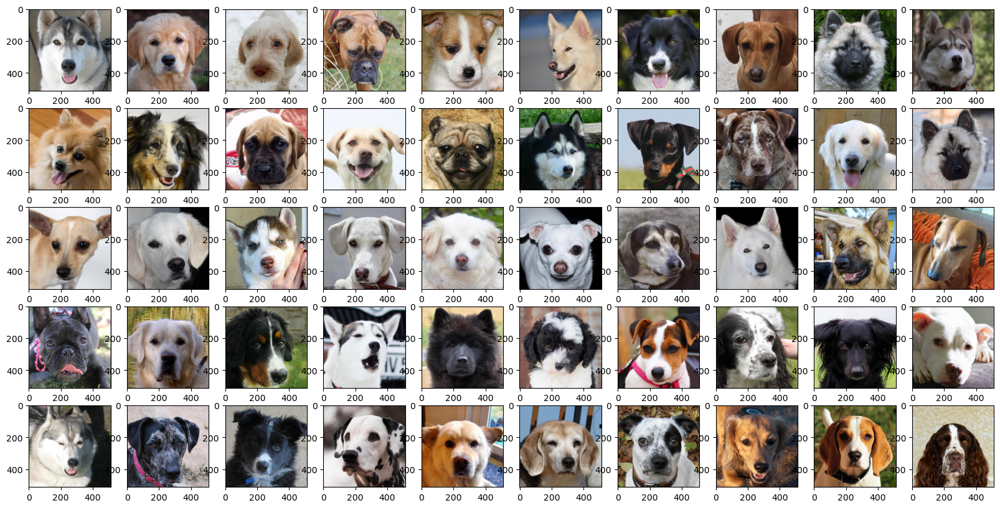

In [15]:
# Show Dog images

random.seed(27)
sampled_dogs = random.sample(dog_files, 50)

fig, ax = plt.subplots(nrows=5, ncols=10, figsize=(20,10))
for idx in range(50):
  row = idx // 10
  col = idx % 10
  dog = plt.imread(sampled_dogs[idx])
  ax[row][col].imshow(dog)

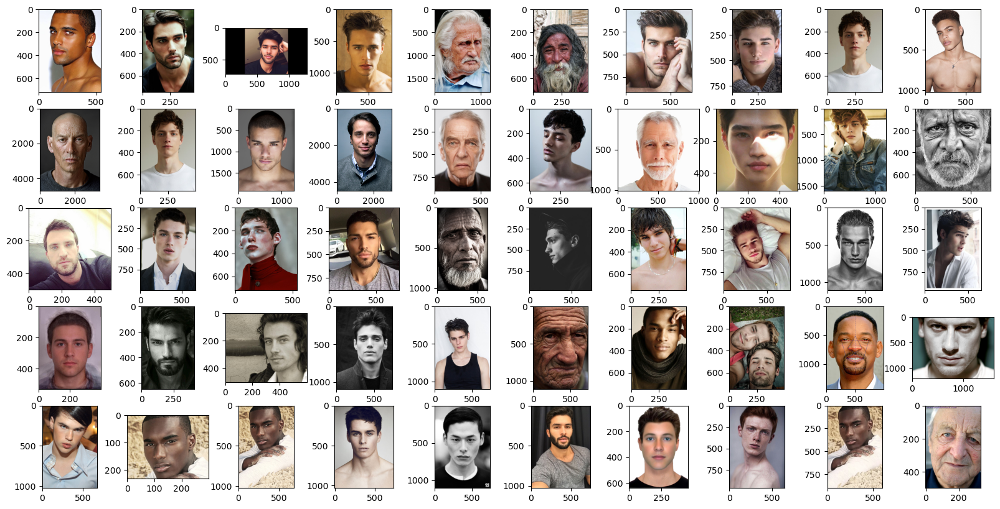

In [16]:
# Show Human images

random.seed(27)
sampled_human = random.sample(human_files, 50)

fig, ax = plt.subplots(nrows=5, ncols=10, figsize=(20,10))
for idx in range(50):
  row = idx // 10
  col = idx % 10
  human = plt.imread(sampled_human[idx])
  ax[row][col].imshow(human)

## Warna dan Bentuk

>Saya akan mendeskripsikan warna dan bentuk dari masing-masing class sehingga dapat dilihat karakteristik warna dan bentuknya.

### Cat
- Warna pada dataset train kucing dominan ada pada warna oranye, hitam, putih, abu
- Bentuk gambar kucing terdiri dari kucing yang gemuk, proporsional, baby cat
- Warna mata cukup bervariasi ada warna kuning, oranye, hijau (mungkin terkena cahaya), biru
- Telinga kucing secara keseluruhan mirip berbentuk segitiga keatas dan runcing, namun ada juga yang telinga serperti melipat dan juga yang berbentuk bundar
- Warna hidung pada kucing terdiri dari warna hitam dan pink

### Dog
- Warna pada dataset train anjing dominan pada warna hitam, putih, coklat, abu. Mirip seperti data kucing
- Bentuk gambar anjing cukup beragam karena gambar terdiri dari banyak ras anjing berbeda
- Telinga pada anjing sangat bervariasi mulai dari segitiga runcing keatas, telinga daun layu, setengah layu, telinga berambut lebat, runcing kesamping
- Warna mata secara keseluruhan terlihat berwarna hitam, tapi beberapa ada yang terlihat seperti biru dan kuning
- Warna pada hidung di dominasi oleh warna hitam, lalu ada juga beberapa warna pink

### Human
- Warna pada dataset train manusia terdiri dari warna putih, hitam, sawo matang. Ada juga gambar yang merupakan black and white.
- Secara kasat mata warna mata manusia berwarna hitam
- Ada yang memiliki rambut dan tidak, ada juga yang rambut tipis
- Warna pada rambut dominan hitam, ada juga warna coklat dan putih pada manusia yang memiliki keriput atau sudah tua


## Ukuran

> Saya akan cek ukuran pixel yang dimiliki dari masing-masing class.

### Cat
Ukuran dataset kucing kurang lebih memiliki pixel yang sama yaitu 500 x 500

### Dog
Ukuran dataset anjing kurang lebih memiliki pixel yang sama yaitu 500 x 500

### Human
Ukuran dataset manusia cukup beragam ada yang berbentuk potrait dan juga landscape. Pixelnya terdiri dari 600 x 500, 4000 x 2000, 1000 x 500

## Ruang Warna (RGB, CMYK)

>Untuk menentukan ruang warna saya mencoba melihat warna dengan membandingkan warna RGB, HSV dan grayscale.

Text(0.5, 1.0, 'Grayscale')

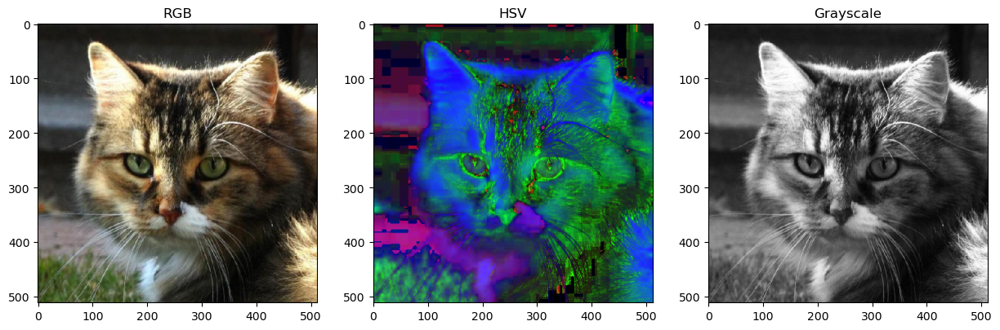

In [17]:
import cv2
import matplotlib.pyplot as plt

img = cv2.imread("data/train_data/cat/cat_001.jpg")
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
img_hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Tampilkan semua versi
fig, ax = plt.subplots(1, 3, figsize=(15, 5))
ax[0].imshow(img_rgb)
ax[0].set_title("RGB")

ax[1].imshow(img_hsv)
ax[1].set_title("HSV")

ax[2].imshow(img_gray, cmap='gray')
ax[2].set_title("Grayscale")

Text(0.5, 1.0, 'Grayscale')

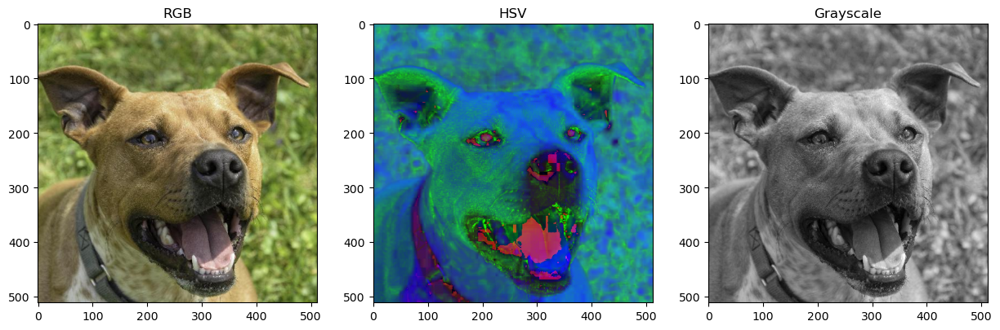

In [18]:
import cv2
import matplotlib.pyplot as plt

img = cv2.imread("data/train_data/dog/dog_001.jpg")
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
img_hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Tampilkan semua versi
fig, ax = plt.subplots(1, 3, figsize=(15, 5))
ax[0].imshow(img_rgb)
ax[0].set_title("RGB")

ax[1].imshow(img_hsv)
ax[1].set_title("HSV")

ax[2].imshow(img_gray, cmap='gray')
ax[2].set_title("Grayscale")

Text(0.5, 1.0, 'Grayscale')

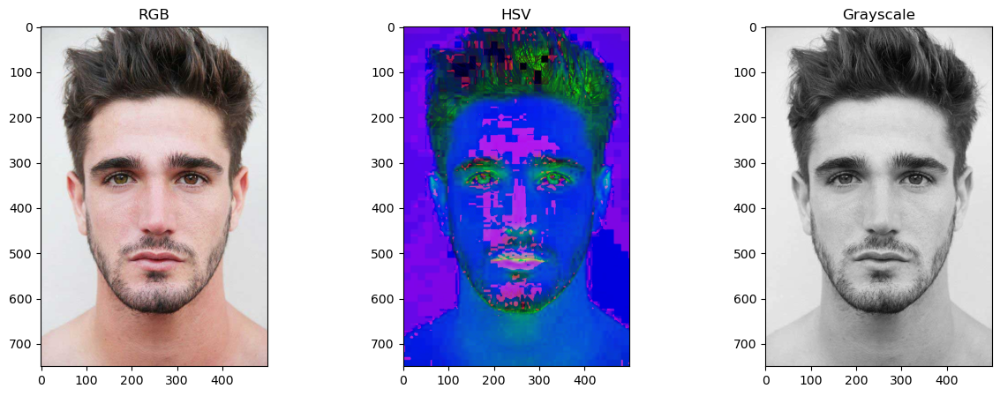

In [19]:
import cv2
import matplotlib.pyplot as plt

img = cv2.imread("data/train_data/human/human_001.jpg")
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
img_hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Tampilkan semua versi
fig, ax = plt.subplots(1, 3, figsize=(15, 5))
ax[0].imshow(img_rgb)
ax[0].set_title("RGB")

ax[1].imshow(img_hsv)
ax[1].set_title("HSV")

ax[2].imshow(img_gray, cmap='gray')
ax[2].set_title("Grayscale")

Setelah melihat perbandingan dari ketiga warna diatas, saya melihat bahwa ruang warna RGB lebih memiliki variasi warna yang jelas dibandingkan HSV dan Grayscale. Namun, ini masih berdasarkan opini dimana masih harus dilakukan analisis lebih lanjut terkait pemilihan penggunaan ruang warna dalam proses klasifikasi model.

## ANGLE

>Saya akan lihat angle yang dimiliki oleh tiap classnya.

### Cat
Secara keseluruhan pengambilan angle pada gambar kucing tepat didepan muka kucing, dari informasi ini saya akan melakukan data augmentation horizontal flip, width shift dan height shift agar data bervariasi tidak selalu muka kucing berada ditengah.

### Dog
Sama seperti kucing, pengambilan angle untuk anjing secara keseluruhan berada di center. Dari informasi ini saya akan melakukan data augmentation horizontal flip, width shift dan height shift agar data bervariasi.

### Human
Angle pada manusia cukup bervariasi jika dilihat dari sampel. Angle yang paling dominan adalah angle yang menghadap kamera dan tegak lurus. Kebanyakan gambar diambil secara selfie. 

## Karakteristik Lain

> Terakhir saya akan analisis terkait karakteristik lainnya dalam masing-masing class. Apakah class terdirik dari satu object atau multiple object? apakah backgroundnya polos, png atau berdiri di sebuah objek?

### Cat
- Objek gambar individual tidak ada gambar yang multiple
- Background kebanyakan bokeh dan berada di luar ruangan, ada yang menghadap warna polos seperti tembok, ada yang tidur dilantai sangat bervariasi

### Dog
- Objek gambar individual tidak ada gambar yang multiple
- Background kebanyakan bokeh dan berada di luar ruangan, ada terlihat sedang tidur dilantai dan juga background polos seperti menghadap tembok

### Human
- Ada gambar yang terdiri dari 2 muka manusia
- Kebanyakan backgorund polos, namun ada beberapa yang sedang diluar ruangan seperti di mobil atau kasur


`Secara keseluruhan` dari hasil EDA, masing-masing class berfokus di area wajah sehingga terdapat kemungkinan jika gambar yang dimasukkan untuk prediksi nanti pada model yang dibuat bukan merupakan wajah dari cat, dog, human model menjadi tidak akurat.

# Bab 4 - Feature Engineering

Pertama saya akan memisahkan data train, val dan test. Sekaligus melakukan data augmentation pada dataset agar data bervariasi. Width_shift dan height shift dilakukan agar gambar memiliki variasi tidak selalu berada di center, untuk zoom dilakukan juga untuk menambah variasi data sehingga ada data yang gambarnya besar dan juga kecil. Target size akan saya ubah menjadi 200 x 200 agar tidak terlalu besar pixelnya saat proses training dan juga agar menyamakan pixel yang dimiliki oleh class human. Class mode sparse juga digunakan untuk menentukan label dari data dengan mengembalikan label sebagai angka integer. Data validation yang digunakan sebesar 40%.

In [57]:
# Example of how to split dataset into train-set and validation-set using `flow_from_dataframe`

train_datagen = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1./255.,
                                                                width_shift_range=[-30, 30],
                                                                height_shift_range=[-30, 30],
                                                                zoom_range=[0.3, 1.5],
                                                                validation_split=0.4)
train = train_datagen.flow_from_dataframe(img_df,
                                    x_col='images',
                                    y_col='label',
                                    target_size=(200,200),
                                    class_mode='sparse',
                                    subset='training',
                                    shuffle=True,
                                    seed=2)
val = train_datagen.flow_from_dataframe(img_df,
                                  x_col='images',
                                  y_col='label',
                                  target_size=(200,200),
                                  class_mode='sparse',
                                  subset='validation',
                                  shuffle=True,
                                  seed=2)

test_datagen = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1./255.)
test = test_datagen.flow_from_dataframe(test_img_df,
                                  x_col='images',
                                  y_col='label',
                                  target_size=(200,200),
                                  class_mode='sparse',
                                  shuffle=False,
                                  seed=2)

Found 2765 validated image filenames belonging to 3 classes.
Found 1843 validated image filenames belonging to 3 classes.
Found 1152 validated image filenames belonging to 3 classes.


Mari kita lihat pixel dari gambar pertama, apakah pixel telah berhasil discaling menjadi rentang 0-1?.  

In [21]:
# Show pixel

images, labels = train[0]
first_img = images[0]

print("Image shape:", first_img.shape)

r, g, b = first_img[0][0] # Pixel di baris 0, kolom 0
print(f"R: {r}, G: {g}, B: {b}")

Image shape: (200, 200, 3)
R: 0.41960787773132324, G: 0.40000003576278687, B: 0.38823533058166504


Gambar berhasil di load dan memperliharkan hasil 200 x 200 pixel dengan 3 channel warna RGB. Gambar pun berhasil di scaling dengan rentang 0-1 hasil dari pembagian 255. 

Selanjutnya mari kita cek masing-masing label classnya pada tiap data train, val dan test.

In [22]:
# Show labels

print(train.class_indices)
print(val.class_indices)
print(test.class_indices)

{'cat': 0, 'dog': 1, 'human': 2}
{'cat': 0, 'dog': 1, 'human': 2}
{'cat': 0, 'dog': 1, 'human': 2}


Oke label tiap class telah di tetapkan, selanjutnya saya akan menyimpan nama class kedalam variable yang nantinya akan disimpan.

In [23]:
class_name = list(train.class_indices.keys())
class_name

['cat', 'dog', 'human']

Class telah berhasil diberi label.

Mari kita lihat gambar dari data train dan validationnya untuk melihat sampel yang akan di train dan telah dilakukan data augmentation.

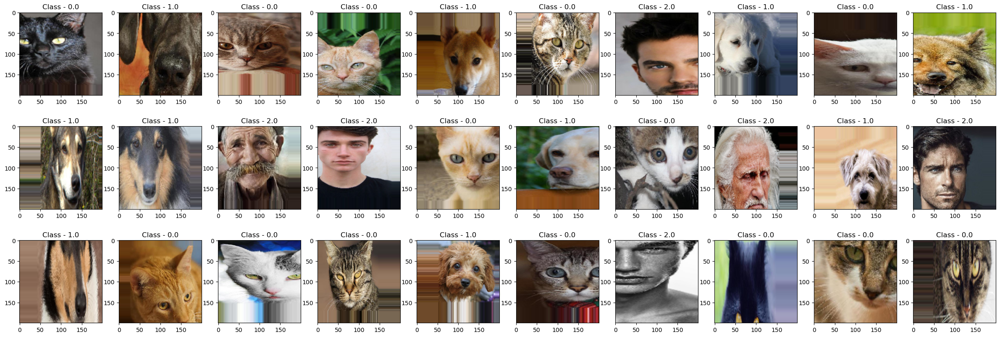

In [24]:
# Show images of train-set

fig, ax = plt.subplots(nrows=3, ncols=10, figsize=(30,10))
n = 0

for i in range(3):
  for j in range(10):
    img = train[0][0][n]
    ax[i][j].imshow(img)
    ax[i][j].set_title('Class - ' + str(train[0][1][n]))
    n += 1

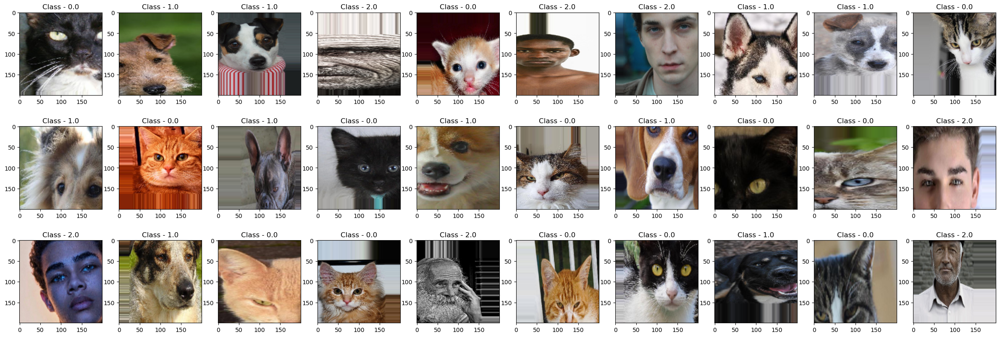

In [25]:
# Show images of val-set

fig, ax = plt.subplots(nrows=3, ncols=10, figsize=(30,10))
n = 0

for i in range(3):
  for j in range(10):
    img = val[0][0][n]
    ax[i][j].imshow(img)
    ax[i][j].set_title('Class - ' + str(val[0][1][n]))
    n += 1

Data train telah berhasil diubah sesuai dengan teknik data augmentation yang diinginkan dimana data telah di geser kanan, kiri, atas, dan bawah. Lalu ada juga gambar yang zoom in dan zoom out sehingga gambar semakin bervariasi untuk proses modeling.

Mari kita training model kita!

# Bab 5 - ANN Training (Sequential API)

Pertama saya akan melakukan proses definisi model yang akan saya gunakan.

## Model Definition

Sebelum mendefinisikan model, saya akan menentukan seed yang digunakan agar model yang dirunning ulang tidak akan terjadi perubahan pada nilai accuracy dan loss nya. Tidak lupa menambahkan clear_session jika ingin melakukan proses training ulang sehingga model tidak melakukan looping atau epoch mulai dari proses training terakhir dimana model akan menjadi overfit.

In [ ]:
# Clear session

seed = 20
tf.keras.backend.clear_session()
np.random.seed(seed)
tf.random.set_seed(seed)

Pada model pertama ini saya akan menggunakan arsitektur sebagai berikut:
- Model saya berikan convolution layer principal dengan kernel 3x3 yang dilakukan sebanyak 3 kali bertahap yaitu sebanyak 32 >> 64 >> 128 filter. Dimana semakin banyak filter maka fitur akan semakin kompleks dalam mendeteksi gambar dan semakin besar kernel fitur akan semakin general dalam mendeteksi gambar.
- Melakukan MaxPooling dengan filter 2x2 untuk memperkecil pixel dalam proses training
- Activation function yang digunakan pada input dan hidden layer adalah relu agar nilai tidak bernilai negatif dan mengurangi masalah vanishing gradient
- Activation function yang digunakan pada output adalah softmax karena model merupakan multiclass classification dimana terdapat 3 class yang akan di classifikasi
- Optimizer yang digunakan adalah Adam karena merupakan optimizer yang paling populer dan biasa digunakan pertama kali untuk proses training
- Metrics yang digunakan adalah accuracy karena datasetnya seimbang

In [ ]:
# Create Sequential API model

model_1 = tf.keras.models.Sequential()
model_1.add(tf.keras.layers.Conv2D(32, (3,3), activation='relu', input_shape=(200, 200, 3)))
model_1.add(tf.keras.layers.MaxPooling2D(2, 2))
model_1.add(tf.keras.layers.Conv2D(64, (3,3), activation='relu'))
model_1.add(tf.keras.layers.MaxPooling2D(2, 2))
model_1.add(tf.keras.layers.Conv2D(128, (3,3),activation='relu'))
model_1.add(tf.keras.layers.MaxPooling2D(2, 2))
model_1.add(tf.keras.layers.GlobalAveragePooling2D())
model_1.add(tf.keras.layers.Dense(512, activation='relu'))
model_1.add(tf.keras.layers.Dense(3, activation='softmax'))

# Compile
model_1.compile(loss='sparse_categorical_crossentropy',
              optimizer='adam',
              metrics=['accuracy'])
model_1.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 198, 198, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2  (None, 99, 99, 32)        0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 97, 97, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 48, 48, 64)        0         
 g2D)                                                            
                                                                 
 conv2d_2 (Conv2D)           (None, 46, 46, 128)       73856     
                                                                 
 max_pooling2d_2 (MaxPoolin  (None, 23, 23, 128)       0

Mari kita visualisasikan model arsitekturnya

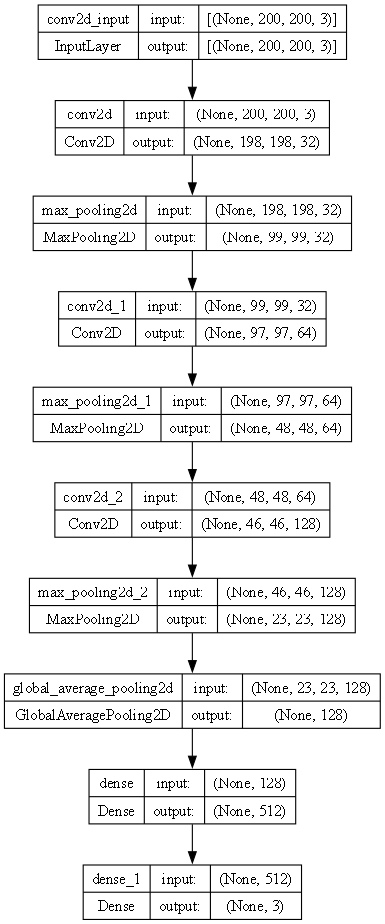

In [ ]:
# Plot layers

tf.keras.utils.plot_model(model_1, show_shapes=True, dpi=80)

## Model Training

> Saya akan training model dengan 50 epoch sehingga data dapat mempelajari model dengan baik, mari kita lihat bagaimana hasil modelnya.

In [ ]:
# Train the model

epoch = 50
history_model_1 = model_1.fit(train, epochs=epoch, validation_data=val, verbose=1)

Epoch 1/50
87/87 [==============================] - 59s 670ms/step - loss: 1.0912 - accuracy: 0.3732 - val_loss: 1.0852 - val_accuracy: 0.3798
Epoch 2/50
87/87 [==============================] - 58s 664ms/step - loss: 1.0687 - accuracy: 0.4061 - val_loss: 1.0634 - val_accuracy: 0.4113
Epoch 3/50
87/87 [==============================] - 58s 662ms/step - loss: 1.0411 - accuracy: 0.4448 - val_loss: 1.0412 - val_accuracy: 0.4232
Epoch 4/50
87/87 [==============================] - 58s 668ms/step - loss: 1.0212 - accuracy: 0.4618 - val_loss: 0.9870 - val_accuracy: 0.4590
Epoch 5/50
87/87 [==============================] - 58s 664ms/step - loss: 0.9788 - accuracy: 0.5078 - val_loss: 0.9819 - val_accuracy: 0.4986
Epoch 6/50
87/87 [==============================] - 57s 663ms/step - loss: 0.9246 - accuracy: 0.5537 - val_loss: 0.8686 - val_accuracy: 0.5795
Epoch 7/50
87/87 [==============================] - 58s 662ms/step - loss: 0.8716 - accuracy: 0.5866 - val_loss: 0.8560 - val_accuracy: 0.5931

Model selesai di training, mari kita lakukan evaluasi.

## Model Evaluation

Kita tampilkan visualisasi loss dan accuracy pada model pertama kita.

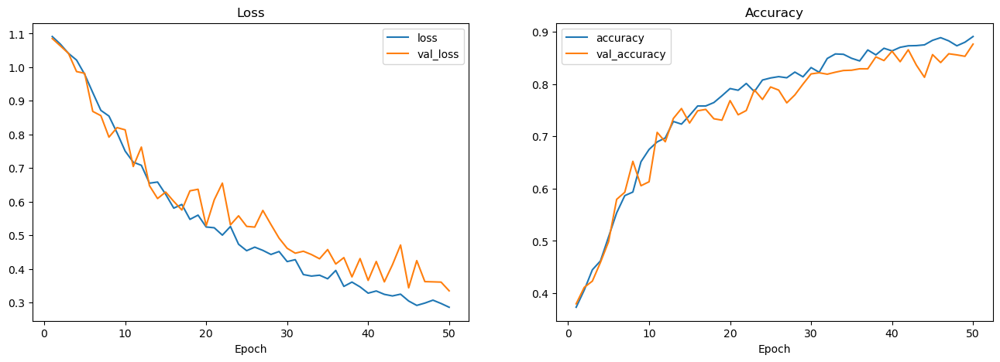

In [ ]:
# Plot training results

fig, ax = plt.subplots(ncols=2,figsize=(16,5))
ax[0].plot(range(1, epoch+1), history_model_1.history['loss'], label='loss')
ax[0].plot(range(1, epoch+1), history_model_1.history['val_loss'], label='val_loss')
ax[0].set_title('Loss')
ax[0].legend()
ax[0].set_xlabel('Epoch')
#ax[0].set_ylim(0,0.01)

ax[1].plot(range(1, epoch+1), history_model_1.history['accuracy'], label='accuracy')
ax[1].plot(range(1, epoch+1), history_model_1.history['val_accuracy'], label='val_accuracy')
ax[1].set_title('Accuracy')
ax[1].legend()
ax[1].set_xlabel('Epoch')
#ax[1].set_ylim(0.5,1.5)

plt.show()

Terlihat dari gambar bahwa model ini mampu mengurangi loss hingga 0.2862 pada data train dan 0.3351 pada data val. Ada kemungkinan model bersifat underfit jika dilihat dari penurunan loss pada data train dan test yang masih terus menurun, namun jika dilihat pada nilai akhir nilai tergolong goodfit dimana gap antara nilai accuracy data train dan val tidak jauh berbeda yaitu sebesar (89.08%) pada data train dan (87.63%) pada data validation.

Mari kita predict data test dan lihat nilai accuracynya.

In [ ]:
# Predict test-set

model_1.evaluate(test)

36/36 [==============================] - 28s 799ms/step - loss: 0.4401 - accuracy: 0.8689


[0.44007954001426697, 0.8689236044883728]

Ternyata model pertama kita sudah mampu memprediksi sekitar 86 % dengan nilai loss sebesar 0.44. Tidak buruk!

Selanjutnya saya akan melihat classification report dan confusion matrix pada model pertama.

Classification Report:
              precision    recall  f1-score   support

         cat       0.80      0.89      0.84       384
         dog       0.86      0.84      0.85       384
       human       0.97      0.89      0.92       384

    accuracy                           0.87      1152
   macro avg       0.87      0.87      0.87      1152
weighted avg       0.87      0.87      0.87      1152

Confusion Matrix:
[[340  39   5]
 [ 56 321   7]
 [ 31  13 340]]


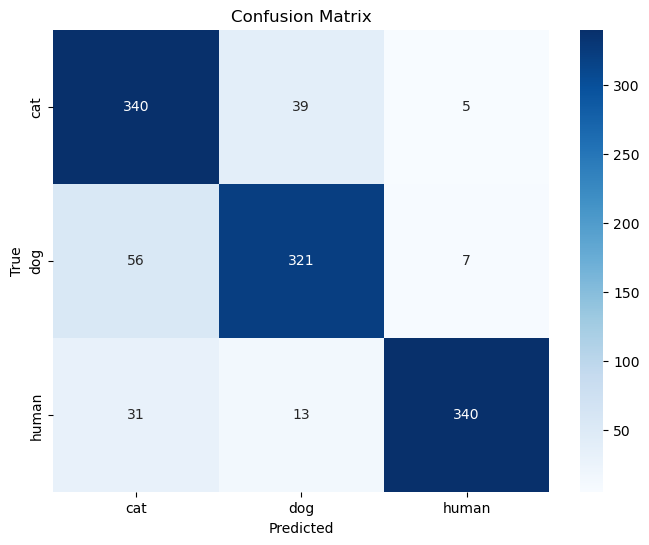

In [ ]:
# Dapatkan jumlah batch
num_batches = len(test)

# Ambil semua label asli dari test set
y_true_1 = []
y_pred_1 = []

for i in range(num_batches):
    # Ambil satu batch data dan label
    x_batch, y_batch = test[i]

    # Prediksi batch
    y_pred_1_probs = model_1.predict(x_batch, verbose=0)
    y_pred_1_batch = np.argmax(y_pred_1_probs, axis=1)

    # Simpan hasilnya
    y_true_1.extend(y_batch)
    y_pred_1.extend(y_pred_1_batch)

# Konversi jadi array
y_true_1 = np.array(y_true_1)
y_pred_1 = np.array(y_pred_1)

# Classification Report
print("Classification Report:")
print(classification_report(y_true_1, y_pred_1, target_names=list(test.class_indices.keys())))

# Confusion Matrix
cm = confusion_matrix(y_true_1, y_pred_1)
print("Confusion Matrix:")
print(cm)

# Visualisasi Confusion Matrix
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=test.class_indices.keys(), yticklabels=test.class_indices.keys())
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()

Karena mengurangi False Positive dan False Negative sama-sama penting pada aplikasi ini, saya akan melihat score f1 score pada model. Jika kita lihat dari hasil f1-score, model lebih baik dalam memprediksi gambar `human` dimana nilainya sebesar 92% lalu untuk prediksi dog dan cat hampir sama dengan selisih 1% yaitu 85% untuk dog dan 84% untuk cat.

Selanjutnya mari kita lihat karakteristik masing-masing gambar dengan membuat result dan fungsi untuk melihat sample dari tiap TP,FP,FN dan TN.

In [ ]:
# Mapping dari class_indices (misal: {'cat':0, 'dog':1, 'human':2})
label_to_name = {v: k for k, v in test.class_indices.items()}

# Ambil semua paths gambar
paths_from_gen = test.filepaths

# List untuk simpan hasil
results_1 = []

for i in range(len(y_true_1)):
    result = {
        'index': i,
        'path': paths_from_gen[i],
        'true_label': int(y_true_1[i]),
        'pred_label': int(y_pred_1[i])
    }
    results_1.append(result)

In [101]:
# Buat fungsi untuk melihat hasil confusion matrix
def plot_tp_fp_fn_tn(results, label_to_name, target_class):
    # Cari TP, FP, FN, TN
    tp = [r for r in results if r['true_label'] == target_class and r['pred_label'] == target_class]
    fp = [r for r in results if r['true_label'] != target_class and r['pred_label'] == target_class]
    fn = [r for r in results if r['true_label'] == target_class and r['pred_label'] != target_class]
    tn = [r for r in results if r['true_label'] != target_class and r['pred_label'] != target_class]

    print(f"Analyzing class '{label_to_name[target_class]}'")
    print(f"TP count: {len(tp)}, FP count: {len(fp)}, FN count: {len(fn)}, TN count: {len(tn)}")

    # Ambil 3 sampel dari masing-masing kategori
    sample_tp = random.sample(tp, min(3, len(tp)))
    sample_fp = random.sample(fp, min(3, len(fp)))
    sample_fn = random.sample(fn, min(3, len(fn)))
    sample_tn = random.sample(tn, min(3, len(tn)))

    # Gabungkan semua, beri label kategori
    all_samples = [
        ('TP', sample_tp),
        ('FP', sample_fp),
        ('FN', sample_fn),
        ('TN', sample_tn)
    ]

    plt.figure(figsize=(10, 15))  # Besarkan ukuran biar tidak rapat

    for row_idx, (label, samples) in enumerate(all_samples):
        for col_idx, sample in enumerate(samples):
            img = mpimg.imread(sample['path'])
            plt.subplot(4, 3, row_idx * 3 + col_idx + 1)
            plt.imshow(img)
            plt.title(f"{label}\nTrue: {label_to_name[sample['true_label']]}\nPred: {label_to_name[sample['pred_label']]}", fontsize=8)
            plt.axis('off')

    plt.tight_layout()
    plt.show()

Analyzing class 'cat'
TP count: 340, FP count: 87, FN count: 44, TN count: 681


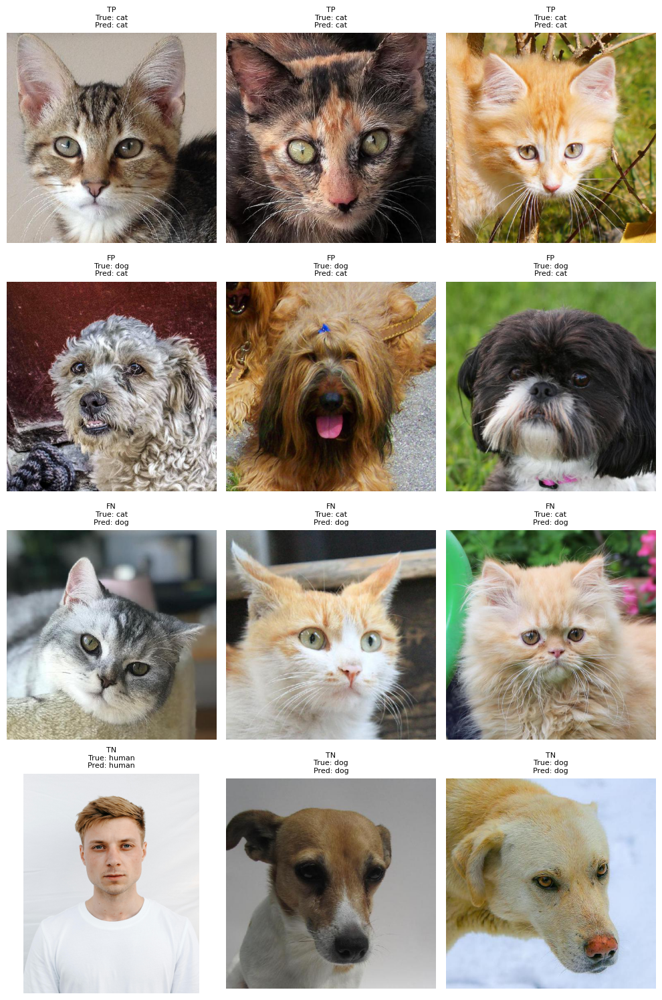

In [102]:
plot_tp_fp_fn_tn(results_1, label_to_name, 0) # Kategori cat

**Insight:**
- True Positive  
Model mampu memprediksi cat dengan nilai f-1 score 84%, jika dilihat dari gambar, terlihat kemiripan pada gambar True Positive ini dimana bentuk cat yang diprediksi benar memiliki rahan yang ramping dan telinga segitiga runcing. Yang menandakan ciri khas dari kucing itu.

- False Positive  
Dari gambar FP yang ditampilkan, terlihat bahwa dog yang di prediksi sebagai cat memiliki wajah yang tidak terlalu terlihat. Badan pada dog ini pun kecil mirip seperti kucing.
 
- False Negative  
Dari gambar FN ini saya berasumsi bahwa gambar cat yang diprediksi dog terjadi karena warna pada cat dan telinga yang dimiliki gambar ini cenderung mirip dengan ciri-ciri yang dimiliki dataset pada dog.

- True Negative  
Model mampu memprediksi data lain dengan benar

Analyzing class 'dog'
TP count: 321, FP count: 52, FN count: 63, TN count: 716


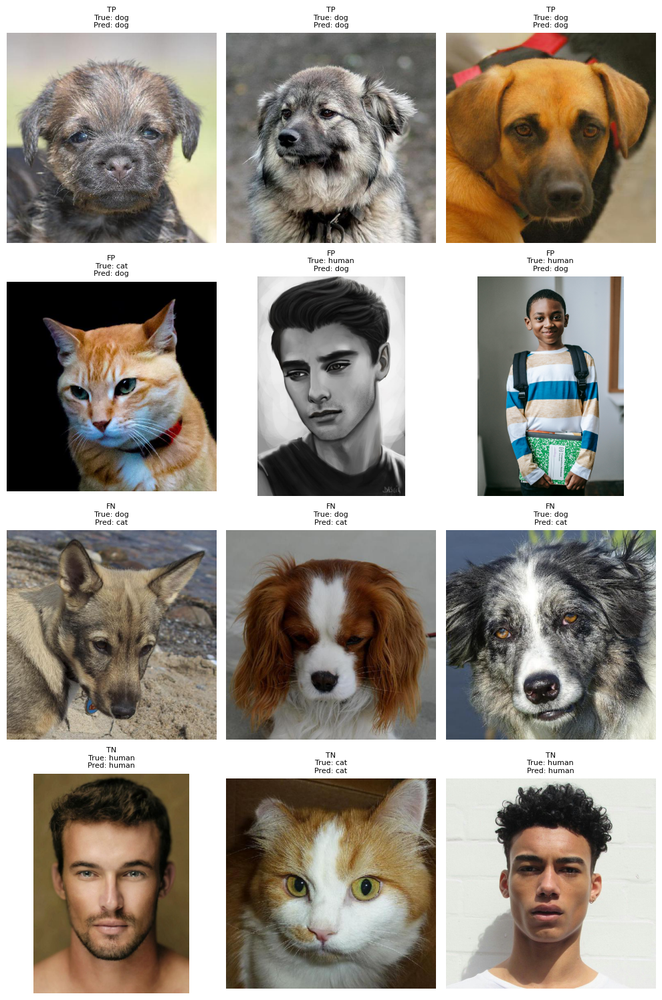

In [103]:
plot_tp_fp_fn_tn(results_1, label_to_name, 1) # Kategori dog

**Insight:**
- True Positive  
Hasil model memiliki f-1 score sebesar 85%, dari gambar TP pada class dog, menunjukkan kemiripan antara bentuk telinga yang layu, bentuk rahang yang cenderung lebih panjang, dan hidung yang lebih jelas besar.

- False Positive  
Dari sample gambar FP yang diprediksi sebagai dog, terdapat 1 gambar cat dan 2 gambar human. Untuk hasil cat kemungkinan karena karakteristik rahang yang agak maju membuat model menganggap ini sebagai dog. Lalu untuk prediksi human jika dilihat pada gambar pertama ini bisa terjadi karena gambar merupakan *black white* yang membuat warna hitam mirip seperti dog. Lalu untuk gambar anak kecil bisa diperkirakan terjadi karena kebanyakan class human memiliki karakteristik closeup muka dan untuk yang angle jauh pun biasanya gambar orang dewasa, dimana gambar anak kecil ini kurang banyak pada dataset sehingga model terbiasa memprediksi dog.

- False Negative  
Untuk FN, pada gambar pertama saya asumsi terjadi karena bentuk telinga yang segitiga dimana ini merupakan ciri khas cat. Lalu untuk gambar 2 dan 3 terjadi karena warna dan bulu pada class dog ini mirip seperti cat.

- True Negative  
Model mampu memprediksi data lain dengan benar

Analyzing class 'human'
TP count: 340, FP count: 12, FN count: 44, TN count: 756


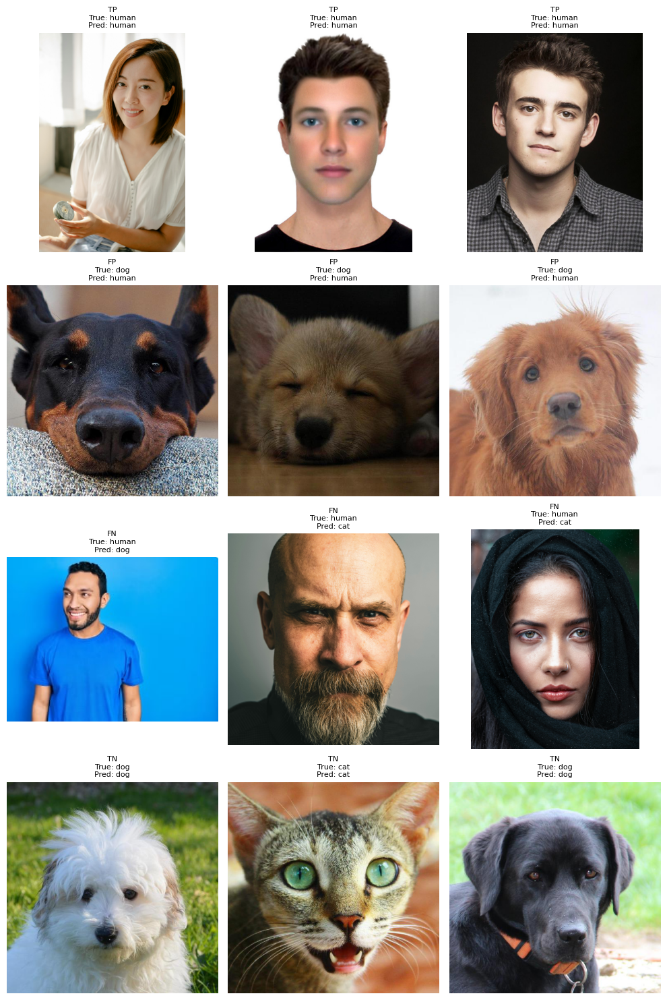

In [109]:
plot_tp_fp_fn_tn(results_1, label_to_name, 2) # Kategori human

**Insight:**
- True Positive  
Untuk class human model mempunyai f-1 score 92%, ini menunjukkan bahwa dataset class human lebih variatif dan mudah dipelajari oleh model sehingga memiliki score tertinggi. Terlihat dari hasil TP, gambar yang ditampilkan ada seorang wanita dan pria yang memang sangat berbeda dari ciri-ciri class dog dan cat.

- False Positive  
Untuk FP pada sample dihasilkan 2 gambar yang sangat close up dengan menempelkan mulutnya pada meja/lantai. Saya asumsi ini terjadi karena pada class dog sedikit gambar yang menempelkan mulutnya pada objek seperti ini, sehingga karena model memang bagus dalam memprediksi human, gambar dianggap sebagai human. Lalu untuk gambar 3, gambar ini mirip dengan manusi jika dilihat dari ekspresi wajahnya.

- False Negative  
Asumsi saya pada FN ini terjadi karena sample gambar yang dihasilkan kurang memiliki karakteristik-karakteristik pada class human. 

- True Negative  
Model mampu memprediksi data lain dengan benar

`Insight Model 1:`

**Arsitektur:**
- Cukup sederhana: 3 blok Conv2D + MaxPooling, lalu GlobalAveragePooling, diakhiri Dense 512 -> Dense 3 (Softmax).
- Total parameter: 160,835 (~629 KB), relatif ringan, cocok untuk deployment cepat.
- Tidak ada regulasi tambahan (batch normalization, dropout).

**Hasil Training:**
- Train accuracy 89.08%, val accuracy 87.63%, test accuracy 86.89%.
- Loss train: 0.2862, val loss: 0.3351, test loss: 0.4401.
- Indikasi: model cukup baik, tidak overfit, tapi masih ada gap loss antara train-val-test -> potensi improve dengan regulasi dan tuning.

**Kesimpulan Sementara:**
- Model ini bekerja cukup baik sebagai baseline.
- Cocok dipakai jika ingin model yang ringan, mudah dilatih, dan cukup akurat (sekitar 87% di test).
- Namun, untuk target akurasi > 90%, perlu penambahan teknik advance.


# Bab 6 - ANN Improvement (Sequential API)

Untuk meningkatkan performa model, saya akan membuat model kedua yang lebih kompleks dengan menambahkan teknik regulasi dan tuning seperti batch normalization, dropout, menggunakan weight initializer HeNormal + GlorotNormal di dense layers.

## Model Definition

Kita clear_session terlebih dahulu dan definisikan seednya.

In [26]:
# Clear session

seed = 20
tf.keras.backend.clear_session()
np.random.seed(seed)
tf.random.set_seed(seed)

Pada model kedua ini saya akan menambahkan arsitektur dari model sebelumnya sebagai berikut:
- Seperti model sebelumnya saya akan tetap menggunakan convolution layer sebanyak 3 kali dengan kernel 3x3 agar model dapat mendeteksi gambar dengan baik.
- Tetap dilakukan maxpooling untuk menyederhanakan pixel dari gambar yang di training.
- Lakukan global average pooling untuk meringkas feature menjadi satu nilai rata-rata per kernel.
- Melakukan BatchNormalization setelah activation function agar mempercepat proses training dan improve model.
- Melakukan Dropout sebesar 0.1 untuk mencegah proses overfitting dimana model terlalu menghafal data training.
- Kernel initializer yang digunakan pada hidden layer dengan activation relu adalah HeNormal dan pada output layer adalah GlorotNormal.
- Untuk sisanya seperti Maxpooling, activation function input dan output, optimizer dan metrics masih sama dengan model sebelumnya.

In [ ]:
# Create Sequential API model

model_2 = tf.keras.models.Sequential()
model_2.add(tf.keras.layers.Conv2D(32, (3,3), activation='relu', input_shape=(200, 200, 3)))
model_2.add(tf.keras.layers.BatchNormalization())
model_2.add(tf.keras.layers.MaxPooling2D(2, 2))
model_2.add(tf.keras.layers.Conv2D(64, (3,3), activation='relu'))
model_2.add(tf.keras.layers.BatchNormalization())
model_2.add(tf.keras.layers.MaxPooling2D(2, 2))
model_2.add(tf.keras.layers.Conv2D(128, (3,3),activation='relu'))
model_2.add(tf.keras.layers.BatchNormalization())
model_2.add(tf.keras.layers.MaxPooling2D(2, 2))
model_2.add(tf.keras.layers.GlobalAveragePooling2D())
model_2.add(tf.keras.layers.Dropout(0.1, seed=seed))
model_2.add(tf.keras.layers.Dense(512, activation='relu', kernel_initializer=tf.keras.initializers.HeNormal(seed)))
model_2.add(tf.keras.layers.BatchNormalization())
model_2.add(tf.keras.layers.Dropout(0.1, seed=seed))
model_2.add(tf.keras.layers.Dense(256, activation='relu', kernel_initializer=tf.keras.initializers.HeNormal(seed)))
model_2.add(tf.keras.layers.BatchNormalization())
model_2.add(tf.keras.layers.Dense(3, activation='softmax', kernel_initializer=tf.keras.initializers.GlorotNormal(seed)))

# Compile
model_2.compile(loss='sparse_categorical_crossentropy',
              optimizer='adam',
              metrics=['accuracy'])
model_2.summary()



Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 198, 198, 32)      896       
                                                                 
 batch_normalization (Batch  (None, 198, 198, 32)      128       
 Normalization)                                                  
                                                                 
 max_pooling2d (MaxPooling2  (None, 99, 99, 32)        0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 97, 97, 64)        18496     
                                                                 
 batch_normalization_1 (Bat  (None, 97, 97, 64)        256       
 chNormalization)                                                
                                                      

Mari kita visualisasikan arsitekturnya.

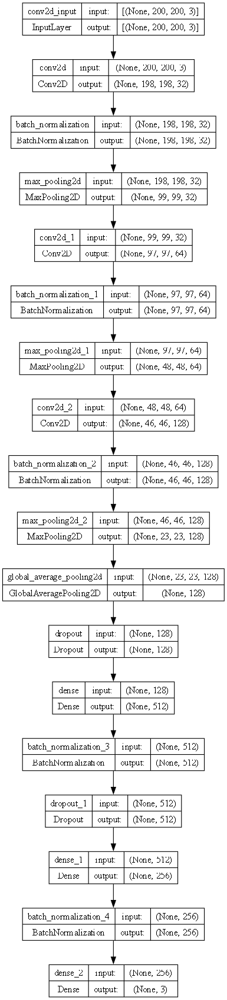

In [ ]:
# Plot layers

tf.keras.utils.plot_model(model_2, show_shapes=True, dpi=80)

## Model Training

> Mari kita training model selanjutnya!

In [ ]:
# Train the model

epoch = 50
history_model_2 = model_1.fit(train, epochs=epoch, validation_data=val, verbose=1)

Epoch 1/50


87/87 [==============================] - 91s 1s/step - loss: 1.1529 - accuracy: 0.5038 - val_loss: 1.1708 - val_accuracy: 0.3630
Epoch 2/50
87/87 [==============================] - 63s 729ms/step - loss: 0.9724 - accuracy: 0.5660 - val_loss: 1.1354 - val_accuracy: 0.3608
Epoch 3/50
87/87 [==============================] - 62s 720ms/step - loss: 0.8500 - accuracy: 0.6116 - val_loss: 1.1343 - val_accuracy: 0.3755
Epoch 4/50
87/87 [==============================] - 63s 722ms/step - loss: 0.7919 - accuracy: 0.6430 - val_loss: 1.4749 - val_accuracy: 0.3695
Epoch 5/50
87/87 [==============================] - 64s 740ms/step - loss: 0.7749 - accuracy: 0.6579 - val_loss: 0.9575 - val_accuracy: 0.5589
Epoch 6/50
87/87 [==============================] - 63s 723ms/step - loss: 0.6909 - accuracy: 0.6995 - val_loss: 1.1480 - val_accuracy: 0.4910
Epoch 7/50
87/87 [==============================] - 63s 724ms/step - loss: 0.7051 - accuracy: 0.6904 - val_loss: 1.6960 - val_accuracy: 0.4145


Model selesai di training, mari kita lakukan evaluasi.

## Model Evaluation

Kita tampilkan visualisasi loss dan accuracy pada model kedua kita.

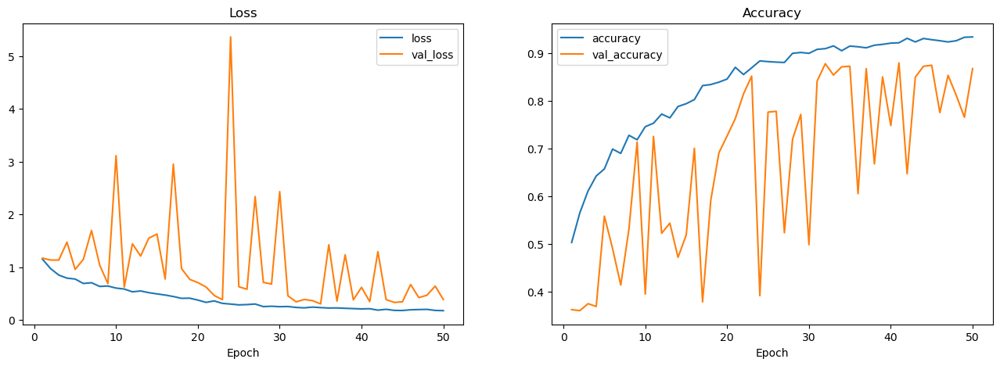

In [ ]:
# Plot training results

fig, ax = plt.subplots(ncols=2,figsize=(16,5))
ax[0].plot(range(1, epoch+1), history_model_2.history['loss'], label='loss')
ax[0].plot(range(1, epoch+1), history_model_2.history['val_loss'], label='val_loss')
ax[0].set_title('Loss')
ax[0].legend()
ax[0].set_xlabel('Epoch')
#ax[0].set_ylim(0,0.01)

ax[1].plot(range(1, epoch+1), history_model_2.history['accuracy'], label='accuracy')
ax[1].plot(range(1, epoch+1), history_model_2.history['val_accuracy'], label='val_accuracy')
ax[1].set_title('Accuracy')
ax[1].legend()
ax[1].set_xlabel('Epoch')
#ax[1].set_ylim(0.5,1.5)

plt.show()

Dapat dilihat pada gambar bahwa loss pada train menurun stabil (model belajar semakin baik di data training), sedangkan pada val_loss sangat fluktuatif (naik turun). Dari grafik loss ini terindikasi model overfitting karena model belajar terlalu fokus pada data training dan tidak generalisasi baik ke data validasi. Namun jika kita lihat hasil akhirnya model mampu mengurangi loss hingga 0.1756 pada data train dan 0.3862 pada data val. Untuk score accuracy antara data train dan val juga cukup jauh yaitu 93.45% pada data train dan 86.81% pada data val yang semakin memperkuat indikasi overfitting pada model.

Mari kita predict data test dan lihat nilai accuracynya

In [ ]:
# Predict test-set

model_2.evaluate(test)

36/36 [==============================] - 28s 789ms/step - loss: 0.2567 - accuracy: 0.9115


[0.2567031681537628, 0.9114583134651184]

Model mampu memprediksi sekitar 91 % gambar pada data test! Peningkatan yang cukup tinggi (5%) dari model sebelumnya yang 86%. Mari kita buat insight pada model kedua.

Classification Report:
              precision    recall  f1-score   support

         cat       0.93      0.91      0.92       384
         dog       0.85      0.93      0.89       384
       human       0.97      0.89      0.93       384

    accuracy                           0.91      1152
   macro avg       0.92      0.91      0.91      1152
weighted avg       0.92      0.91      0.91      1152

Confusion Matrix:
[[349  34   1]
 [ 14 359  11]
 [ 11  31 342]]


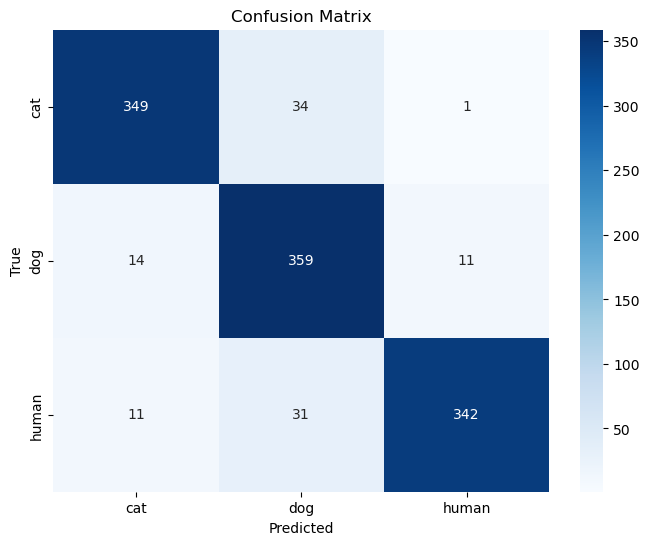

In [ ]:
# Dapatkan jumlah batch
num_batches = len(test)

# Ambil semua label asli dari test set
y_true_2 = []
y_pred_2 = []

for i in range(num_batches):
    # Ambil satu batch data dan label
    x_batch, y_batch = test[i]

    # Prediksi batch
    y_pred_2_probs = model_2.predict(x_batch, verbose=0)
    y_pred_2_batch = np.argmax(y_pred_2_probs, axis=1)

    # Simpan hasilnya
    y_true_2.extend(y_batch)
    y_pred_2.extend(y_pred_2_batch)

# Konversi jadi array
y_true_2 = np.array(y_true_2)
y_pred_2 = np.array(y_pred_2)

# Classification Report
print("Classification Report:")
print(classification_report(y_true_2, y_pred_2, target_names=list(test.class_indices.keys())))

# Confusion Matrix
cm = confusion_matrix(y_true_2, y_pred_2)
print("Confusion Matrix:")
print(cm)

# Visualisasi Confusion Matrix
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=test.class_indices.keys(), yticklabels=test.class_indices.keys())
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()

Dari nilai f1-score model kedua kali ini memiliki nilai yang baik di accuracy 91%. Pada model ini tetap class human menjadi nilai tertinggi yaitu 93% disusul cat 92% dan dog 89%. Selisih yang dimiliki pada tiap class cukup kecil ya berkisar 1-4%.

Selanjutnya mari kita lihat karakteristik TP,FP,TN dan FN.

In [ ]:
# Mapping dari class_indices (misal: {'cat':0, 'dog':1, 'human':2})
label_to_name = {v: k for k, v in test.class_indices.items()}

# Ambil semua paths gambar
paths_from_gen = test.filepaths

# List untuk simpan hasil
results_2 = []

for i in range(len(y_true_2)):
    result = {
        'index': i,
        'path': paths_from_gen[i],
        'true_label': int(y_true_2[i]),
        'pred_label': int(y_pred_2[i])
    }
    results_2.append(result)

Analyzing class 'cat'
TP count: 349, FP count: 25, FN count: 35, TN count: 743


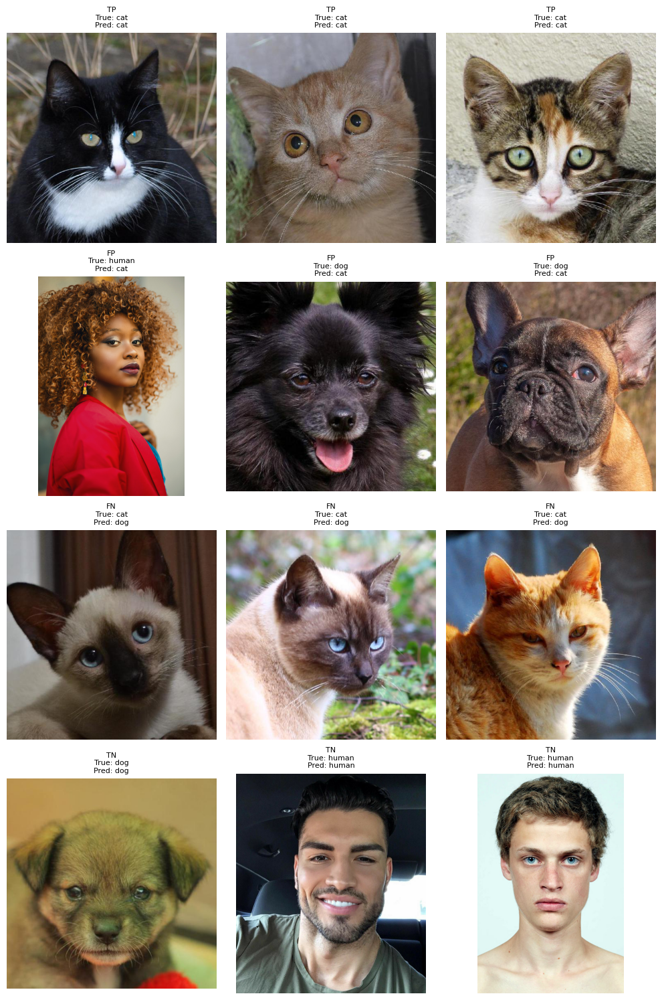

In [106]:
plot_tp_fp_fn_tn(results_2, label_to_name, 0) # Kategori cat

**Insight:**
- True Positive  
Dapat dilihat dari gambar yang berlabel TP, cat yang diprediksi benar memiliki ciri-ciri berbeda ada yang gemuk dan juga kurus. Untuk bentuk telinga masih memiliki ciri khas segitiga dengan warna pada badan bervariasi.

- False Positive  
Pada FP terdapat gambar 1 human dan 2 dog dari sampel. Jika kita lihat pada gambar dog terindikasi bentuk wajah dan telinga memang sedikit mirip dengan kucing. Untuk human, sepertinya karena warna baju muka dan rambut yang sedikit bervariasi, model memiliih gambar sebagai cat.

- False Negative  
Pada FN jika kita lihat dari sampel, didapatkan gambar cat yang di prediksi dog. Pada 2 gambar pertama dapat dilihat warna hidung dan badan memiliki kontras yang jelas dimana warna hidung dan telinga hitam sisanya cream, asumsi saya warna pada cat ini kurang banyak pada data test cat, tetapi lebih banyak di data test dog sehingga ter prediksi dog. Untuk gambar 3 indikasinya dari model rahang dan mata yang mirip dengan dog.

- True Negative  
Model mampu memprediksi data lain dengan benar

Analyzing class 'dog'
TP count: 359, FP count: 65, FN count: 25, TN count: 703


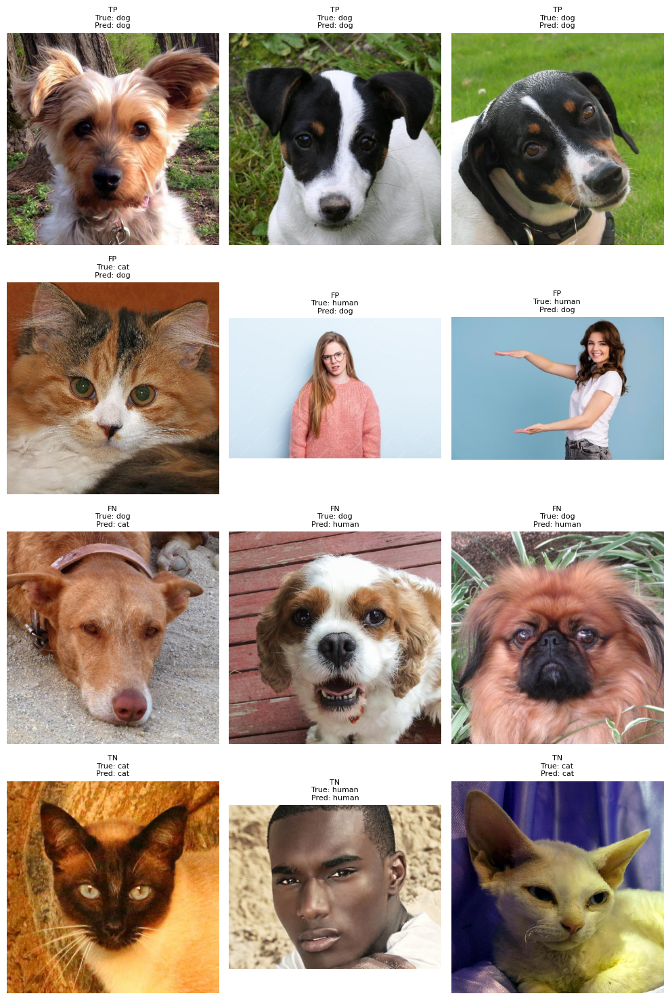

In [107]:
plot_tp_fp_fn_tn(results_2, label_to_name, 1) # Kategori dog

**Insight:**
- True Positive  
Pada TP, karakteristik dog diperlihatkan dengan telinga layu dan rahang yang cenderung panjang. Warna pada gambar sampel juga cukup bervariasi tapi memiliki pola.

- False Positive  
Pada FP, didapatkan 1 gambar cat dan 2 gambar human. Asumsi saya pada gambar pertama terjadi karena gambar cat ini cukup berbeda dari yang lain dimana mukanya cukup lebar sehingga terprediksi dog. Untuk 2 gambar human, asumsinya gambar terlalu jauh untuk menangkap pola pada karakteristik manusias sehingga model memutuskan mengambil prediksi dog.

- False Negative  
Pada FN, sampel gambar 1 terprediksi sebagai cat indikasinya gambar dog yang menempelkan badan ke lantai hanya sedikit lalu karakteristik telinga cat pada gambar ini muncul sehingga terprediksi cat. Untuk 2 sampel selanjutnya terprediksi human karena memiliki mimik wajah yang mirip, dimana dataset pada human memang kebanyakan memiliki pose selfie.

- True Negative  
Model mampu memprediksi data lain dengan benar

Analyzing class 'human'
TP count: 342, FP count: 12, FN count: 42, TN count: 756


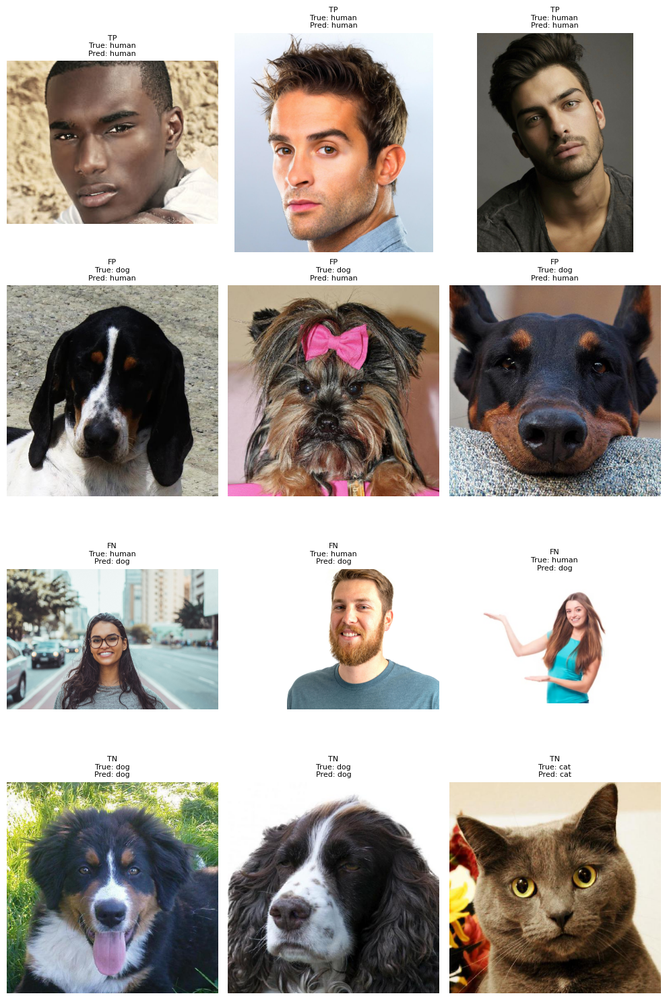

In [108]:
plot_tp_fp_fn_tn(results_2, label_to_name, 2) # Kategori human

**Insight:**
- True Positive  
Pada sampel TP, karakteristik pada human yang dimunculkan adalah warna yang tidak bervariasi pada satu kulit. Hanya ada gelap, sawo matang, dan crem. Untuk posisi juga menghadap ke kamera atau sadar kamera.

- False Positive  
Indikasi pada sampel FP ini diberikan oleh gambar2 dog. Asumsi ini terjadi adalah kurangnya karakteristik dog pada gambar2 tersebut seperti telinga yang tidak terlalu terlihat, foto yang close up, dan mimik wajah yang mirip manusia.

- False Negative  
Pada FN, dapat kita lihat sampel gambar menunjukkan gambar-gambar yang tidak terlalu close up. Sehingga model memprediksi gambar sebagai dog.

- True Negative  
Model mampu memprediksi data lain dengan benar

`Insight Model 2:`

**Arsitektur:**
- Lebih kompleks: 3 blok Conv2D + BatchNormalization + Maxpooling, GlobalAveragePooling, lalu Dense 512 -> BatchNorm -> Dropout -> Dense 256 -> BatchNorm -> Dense 3 (softmax)
- Total parameter: Total params: 295363 (1.13 MB), hampir 2x lipat model pertama.
- Ada regularisasi kuat (batch norm, dropout), arsitektur lebih tahan overfitting.

**Hasil Training:**
- Train accuracy 93.45%, val accuracy 86.81%, test accuracy 91.15%.
- Loss train: 0.1756, val loss: 0.3862, test loss: 0.2567.
- Indikasi: train-val gap cukup besar (train acc tinggi, val acc turun), tapi generalisasi ke test sangat baik -> dropout + batch norm membantu mencegah overfitting.

**Kesimpulan Sementara:**
- Model ini dirancang untuk performa lebih tinggi.
- Bisa menangkap pola data lebih kompleks, dengan toleransi generalisasi lebih baik.
- Bisa ditingkatkan lebih jauh dengan tuning dropout rate, jumlah dense unit dan learning rate scheduler.


## Insight Perbandingan Model 1 vs Model 2

**Kelebihan Model 1**

- Lebih ringan (setengah ukuran), cepat dilatih, risiko komputasi rendah.
- Performanya cukup baik (~87% test accuracy) meski tanpa regularisasi.

**Kelemahan Model 1**

- Tanpa regularisasi → risiko overfitting kalau dataset lebih besar atau bervariasi.
- Batas atas akurasi terlihat (sulit tembus >90% tanpa arsitektur tambahan).

**Kelebihan Model 2**

- Arsitektur modern: batch norm, dropout, hidden dense layer tambahan.
- Performa lebih baik di test set (+4% test accuracy, +0.18 lebih rendah test loss).
- Lebih tahan terhadap overfitting, cocok untuk dataset lebih besar dan kompleks.

**Kelemahan Model 2**

- Lebih berat secara komputasi (2x lebih banyak parameter).
- Val accuracy sedikit turun meskipun train dan test bagus → perlu fine-tuning lebih lanjut.

**Mana yang Terbaik?**

Model 2 adalah pilihan terbaik saat ini karena generalisasi yang lebih kuat, test performance yang lebih baik, dan potensi berkembang dengan fine-tuning.

# Bab 7 - Model Saving

Mari kita save model nya

In [ ]:
# Model summary

model_2.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 198, 198, 32)      896       
                                                                 
 batch_normalization (Batch  (None, 198, 198, 32)      128       
 Normalization)                                                  
                                                                 
 max_pooling2d (MaxPooling2  (None, 99, 99, 32)        0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 97, 97, 64)        18496     
                                                                 
 batch_normalization_1 (Bat  (None, 97, 97, 64)        256       
 chNormalization)                                                
                                                        

Kita lakukan freeze terlebih dahulu pada model agar jika model dijalankan pada device lain, model dapat berjalan dan meminimalisir error yang terjadi.

In [ ]:
# Freeze model

model_2.trainable = False
model_2.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 198, 198, 32)      896       
                                                                 
 batch_normalization (Batch  (None, 198, 198, 32)      128       
 Normalization)                                                  
                                                                 
 max_pooling2d (MaxPooling2  (None, 99, 99, 32)        0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 97, 97, 64)        18496     
                                                                 
 batch_normalization_1 (Bat  (None, 97, 97, 64)        256       
 chNormalization)                                                
                                                        

Save modelnya dengan extension .keras

In [ ]:
# Save ANN model
model_2.save("saved_model")

INFO:tensorflow:Assets written to: saved_model\assets


INFO:tensorflow:Assets written to: saved_model\assets


In [45]:
# Save class
with open('class_name.txt', 'w') as file_1:
    json.dump(class_name, file_1)

# Bab 8 - Model Inference

Ada pada notebook inference_ade_indra.ipynb

# Bab 9 - Kesimpulan

**Kesimpulan:**

Kemampuan model dalam memprediksi objek visual dapat ditentukan dengan membuat arsitektur yang tepat. Dimana arsitektur yang telah ditambahkan beberapa regulasi dapat meningkatkan performance pada model sehingga model_2 memiliki akurasi 91% pada data testnya. Setelah dilakukan inference, hanya terdapat satu kesalahan prediksi yaitu dog diprediksi sebagai human. Ini merupakan hasil yang cukup memuaskan mengingat score pada model yang cukup tinggi.

**Model Improvement:**

Model dapat dilakuakan improvement lanjutan seperti:
- Menaikkan fine-tuning dropout rate misal menjari 0.3-0.5.
- Mengurangi atau menambahkan unit di Dense layer
- Menggunakan EarlyStopping + ReduceLROnPlateu agar training lebih efisien
- Eksperimen optimizer selain adam
- Menambahkan dataset yang lebih bervariasi tidak hanya menampilkan wajah yang menghadap kamera

**Business Insight:**

Dalam konteks bisnis aplikasi deteksi gambar cat, dog dan human agar dapat mengontrol akses ke sebuah ruangan. Beberapa ketentuan harus dimiliki yaitu:
- Sistem harus sangat andal -> kesalahan deteksi bisa langsung berdampak pada operasional
- Contoh dampaknya:
    - False negative (anjing/kucing tidak terdeteksi) -> pintu terbuka dan kebersihan terganggu, potensi komplain pelanggan.
    - False positive (manusia terdeteksi sebagai kucing/anjing) -> pintu tidak terbuka, ganggu kenyamanan pengguna dan terjadi hambatan pekerjaan.
- Akurasi tinggi saja tidak cukup sehingga kita perlu:
    - Robustness atau stabil menghadapi berbagai kondisi pencahayaan, pose dan angle.
    - Low false positive/negative.
    - Efisiensi (model yang ringan, cepat untuk real-time).

**Potensi Kerugian**
- Operational failure - jika model salah memprediksi, toko atau kantor bisa kehilangan reputasi sehingga membuat pelanggan kecewa bahkan kehilangan pendapatan.
- Maintenance cost - model yang belum stabil butuh sering diperbarui atau diperbaiki, yang akan menambah beban tim teknis.
- Latency issue - dengan total parameter 295.363 (1.13 MB), model tidak terlalu besar tapi tidak juga super ringan. Jika hardware pintu otomatis terbasar, waktu memprediksi inference bisa jadi masalah.
- Scalability dan Security Risk - jika model tidak diuji di skenario nyata seperti kamera dengan kualitas buruk/malam hari, bisa bocor dan gagal secara tak terduga.